# Modeling a 2D Point
This notebook visualizes the training and generation of a Bayesian flow network [(Graves et al. 2023)](https://arxiv.org/pdf/2308.07037.pdf) modeling a 2D point.

In [12]:
%matplotlib inline
from IPython.display import HTML
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib.colors import LogNorm
import numpy as np
from scipy.stats import norm
import torch

plt.rcParams['mathtext.fontset'] = 'cm'
plt.rcParams['font.family'] = 'STIXGeneral'

In [13]:
from bfn.bayesian_flow_networks import bayesian_flow_distribution
from bfn.config import TrainingConfig, SamplingConfig
from bfn.networks import Network
from bfn.plotting_utils import ema_smooth, rescale_colormap
from bfn.training import train
from bfn.generation import generate

## Plotting code

In [14]:
def visualize_training(losses, ts, gammas, mus, alphas, subsample_every=1):
  # subsampling
  subsampled_losses = losses[::subsample_every]
  subsampled_ts = ts[::subsample_every]
  subsampled_gammas = gammas[::subsample_every]
  subsampled_mus = mus[::subsample_every]
  subsampled_alphas = alphas[::subsample_every]
  indices = range(len(subsampled_ts))

  cmap = 'inferno'
  scatter_size = 0.5

  fig, axes = plt.subplots(2, 5, figsize=(30, 8))

  # Plot 0: Scatter plot of ts
  sc0 = axes[0, 0].scatter(indices, subsampled_ts, s=scatter_size, c=indices, cmap=cmap)
  axes[0, 0].set_title("$t$ with respect to training steps")

  # Plot 1: Scatter plot of ts with respect to ts
  axes[1, 0].scatter(subsampled_ts, subsampled_ts, s=scatter_size, c=indices, cmap=cmap)
  axes[1, 0].set_title("$t$ with respect to $t$")

  # Plot 2: Scatter plot of gammas
  axes[0, 1].scatter(indices, subsampled_gammas, s=scatter_size, c=indices, cmap=cmap)
  axes[0, 1].set_title("$\\gamma$ with respect to training steps")

  # Plot 3: Scatter plot of gammas with respect to ts
  axes[1, 1].scatter(subsampled_ts, subsampled_gammas, s=scatter_size, c=indices, cmap=cmap)
  axes[1, 1].set_title("$\\gamma$ with respect to $t$")

  # Plot 4: Scatter plot of alphas
  axes[0, 2].scatter(indices, subsampled_alphas, s=scatter_size, c=indices, cmap=cmap)
  axes[0, 2].set_title("$\\alpha$ with respect to training steps")

  # Plot 5: Scatter plot of alphas with respect to ts
  axes[1, 2].scatter(subsampled_ts, subsampled_alphas, s=scatter_size, c=indices, cmap=cmap)
  axes[1, 2].set_title("$\\alpha$ with respect to $t$")

  sorted_indices = np.argsort(subsampled_ts)
  sorted_points = subsampled_mus[sorted_indices]
  sorted_ts = subsampled_ts[sorted_indices]

  # Plot 6: 2D scatter plot of mus trajectory
  sc6 = axes[0, 3].scatter(sorted_points[:, 0], sorted_points[:, 1], c=sorted_ts, cmap='viridis', s=scatter_size)
  axes[0, 3].set_title("Scatter plot of $\\mu$")
  cbar4 = plt.colorbar(sc6, ax=axes[0, 3], orientation='vertical')
  cbar4.set_label('Time Step')
  axes[0, 3].set_xlabel('$x_0$')
  axes[0, 3].set_ylabel('$x_1$')

  # Remove the original 2D subplot at [1, 3] to make space for a 3D subplot
  axes[1, 3].remove()
  ax7 = fig.add_subplot(2, 5, 9, projection='3d')  # 9th position in a 2x5 grid, row-major

  # Plot 7: 3D scatter plot of mus trajectory
  sc7 = ax7.scatter(sorted_points[:, 0], sorted_points[:, 1], sorted_ts, c=sorted_ts, cmap='viridis', s=scatter_size)
  ax7.set_title("Scatter plot of $\\mu$ over time")
  cbar5 = plt.colorbar(sc7, ax=ax7, orientation='vertical', pad=0.15)
  cbar5.set_label('Time Step')
  ax7.set_xlabel('$x_0$')
  ax7.set_ylabel('$x_1$')
  ax7.set_zlabel('$t$')

  # Plot 8: Line plot of losses
  axes[0, 4].scatter(range(len(subsampled_losses)), subsampled_losses, s=scatter_size, alpha=0.5)
  axes[0, 4].set_title("losses")

  # Plot 9: Line plot of ema_smooth of losses
  ema_smoothed_losses = ema_smooth(subsampled_losses, alpha=0.01)
  axes[1, 4].scatter(range(len(subsampled_losses)), ema_smoothed_losses, s=scatter_size, alpha=0.5)
  axes[1, 4].set_title("EMA of losses")

  cbar_ax = fig.add_axes([0.15, 0.08, 0.7, 0.02])
  cbar = fig.colorbar(sc0, cax=cbar_ax, orientation='horizontal')
  cbar.set_label('training steps')

  fig.subplots_adjust(left=0.1, right=0.9, bottom=0.15, top=0.95, wspace=0.3, hspace=0.3)

In [15]:
def visualize_generation(samples, mus, ys):
  fig, axes = plt.subplots(2, 4, figsize=(20, 10))

  cmap = rescale_colormap('viridis')

  colormaps = ['Blues', 'Reds', 'Greens', 'Purples']
  readjusted_colormaps = [rescale_colormap(cmap_name) for cmap_name in colormaps]
  
  assert samples.shape[0] == mus.shape[0] == ys.shape[0]
  if samples.shape[0] > len(readjusted_colormaps):
     samples = samples[:len(readjusted_colormaps)]
     mus = mus[:len(readjusted_colormaps)]
     ys = ys[:len(readjusted_colormaps)]
  elif samples.shape[0] < len(readjusted_colormaps):
     readjusted_colormaps = readjusted_colormaps[:samples.shape[0]]

  def _plot_scatter(ax, data, name):
    ax.scatter(data[0, :, 0], data[0, :, 1], c=np.arange(data.shape[1]), cmap=cmap, s=1)
    ax.set_title(f'Scatterplot of a single generation run for {name}')
    ax.set_xlabel('Dimension 0')
    ax.set_ylabel('Dimension 1')
    ax.annotate('$\\times$', xy=(-0.8, 0.8), fontsize=20, ha='center', va='center')

  def _plot_single_trajectory(ax, data, name):
    trajectory = data[0]
    for i in range(1, len(trajectory)):
        x_values = trajectory[i-1:i+1, 0]
        y_values = trajectory[i-1:i+1, 1]
        color = cmap(i / len(trajectory))
        ax.plot(x_values, y_values, color=color)
    ax.set_title(f'Trajectory of a single generation run for {name}')
    ax.set_xlabel('Dimension 0')
    ax.set_ylabel('Dimension 1')
    ax.annotate('$\\times$', xy=(-0.8, 0.8), fontsize=20, ha='center', va='center')

  def _plot_multiple_trajectories(ax, data, name):
    for i in range(1, data.shape[1]):
        for j, cmap_name in enumerate(readjusted_colormaps):
            cmap = plt.get_cmap(cmap_name)
            x_values = data[j, i-1:i+1, 0]
            y_values = data[j, i-1:i+1, 1]
            color = cmap(i / data.shape[1])
            ax.plot(x_values, y_values, color=color)
    ax.set_title(f'Trajectories of multiple generation runs for {name}')
    ax.set_xlabel('Dimension 0')
    ax.set_ylabel('Dimension 1')
    ax.annotate('$\\times$', xy=(-0.8, 0.8), fontsize=20, ha='center', va='center')

  # plot ys
  _plot_scatter(axes[0, 0], ys, '$y$')
  _plot_scatter(axes[1, 0], ys, '$y$')

  # plot mus
  _plot_scatter(axes[0, 1], mus, '$\\mu$')
  _plot_single_trajectory(axes[0, 2], mus, '$\\mu$')
  _plot_multiple_trajectories(axes[0, 3], mus, '$\\mu$')

  # plot x_hat
  _plot_scatter(axes[1, 1], samples, '$\\hat{x}$')
  _plot_single_trajectory(axes[1, 2], samples, '$\\hat{x}$')
  _plot_multiple_trajectories(axes[1, 3], samples, '$\\hat{x}$')

  xlims = axes[0, 3].get_xlim()
  ylims = axes[0, 3].get_ylim()

  # make all subplots except subplot (0,0) have same xlim and ylim
  for i in range(axes.shape[0]):
      for j in range(axes.shape[1]):
          if (i, j) != (0, 0):
              axes[i, j].set_xlim(xlims)
              axes[i, j].set_ylim(ylims)

  sm1 = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=0, vmax=samples.shape[1]))
  sm1.set_array([])
  cbar_ax1 = fig.add_axes([0.125, 0.05, 0.575, 0.02])
  plt.colorbar(sm1, cax=cbar_ax1, orientation='horizontal', label='$t$')

  for idx, cmap_name in enumerate(readjusted_colormaps):
      cmap = plt.get_cmap(cmap_name)
      sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=0, vmax=samples.shape[1]))
      sm.set_array([])
      cbar_ax = fig.add_axes([0.92, 0.15 + idx * 0.2, 0.02, 0.15])
      cbar = plt.colorbar(sm, cax=cbar_ax, orientation='vertical')
      cbar.set_label(f'sample {idx}', labelpad=15, rotation=90)

  plt.subplots_adjust(bottom=0.15, hspace=0.3)

## Training
The network is trained to model the scalar $\mathbf{x}=[-0.8, 0.8]$. The network is a simple feedforward network with 64 hidden units that takes the parameter $\mu$ and timestep $t$ as input and whose output is used to estimate $\mathbf{\hat{x}}$ (_Equation 84_). We train for 50k steps with a learning rate of $0.001$ and a batch size of $10$, which takes about 10 seconds. The training loss is defined as
\begin{align}
L^\infty = -\ln \sigma_1 \mathbb{E}_{t \sim U(0,1), p_F(\bm{\theta} | \mathbf{x}; t)} \frac{\lVert \mathbf{x} - \hat{\mathbf{x}(\bm{\theta}, t)}\rVert^2}{\sigma_1^{2t}} \tag{101}
\end{align}

The complete training algorithm can be found in _Algorithm 2_ of the paper.

In [16]:
train_cfg = TrainingConfig(steps=50000, lr=1e-3, batch_size=10)
sampling_cfg = SamplingConfig(sigma_1=0.02)

In [17]:
x = torch.tensor([-0.8, 0.8])
network = Network(indim=2, hdim=64)
network.train()
losses, ts, gammas, mus, alphas = train(network, x, train_cfg, sampling_cfg)

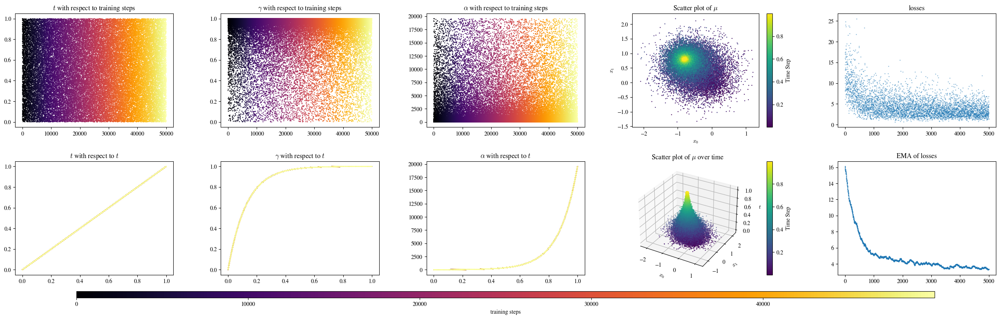

In [18]:
visualize_training(losses, ts, gammas, mus, alphas)

At each step of training we sample a batch of time points $t \in [0, 1]$, which, along with $\sigma_1$, allows us to automatically calculate $\gamma(t)$ which is used for computing $\hat{x}$ and $\alpha(t)$ which is used as a weight coefficient the loss (_Equation 41_). Note the $\alpha$ used here assumes continuous time $t$:
\begin{align}
\alpha(t) = -\frac{2 \ln \sigma_1}{\sigma_1^{2t}}. \tag{74}
\end{align}

Top row, from left to right:
- The sampled time points $t$ ranging from 0 to 1 plotted against the training steps ranging from 0 to 50k.
- The $\gamma(t)$ derived from the sampled time points plotted against the training steps ranging from 0 to 50k.
- The $\alpha(t)$ derived from the sampled time points plotted against the training steps ranging from 0 to 50k.
- The $\bm{\mu}(t)$ sampled from the Bayesian flow distribution at the sampled time points plotted against the training steps ranging from 0 to 50k.
- The raw training loss plotted against the training steps ranging from 0 to 50k.

Bottom row, from left to right:
- The sampled time points $t$ ranging from 0 to 1 plotted against themselves.
- The $\gamma(t)$ derived from the sampled time points plotted against the sampled time points they were derived from.
- The $\alpha(t)$ derived from the sampled time points plotted against the sampled time points they were derived from.
- A 3D plot showing the samples of $\bm{\mu}(t)$ at different time points time, where the $z$-axis represents the progression of time.
- An exponentially-weighted-average of the raw training loss plotted against the sampled time points they were evaluated at. 

Note:
- The distribution of $\bm{\mu}$ starts centered arond $\bm{\mu}_0=[0,0]$, expand outwards, and then concentrates around the ground truth $\mathbf{x} = [-0.8, 0.8]$ as $t$ goes from $0$ to $1$.
- The plots for $t$, $\gamma$, and $\alpha$ are essentially identical to the plots in the 1D case.

## Sampling

Having trained the network to estimate $\hat{\mathbf{x}}$ from $\bm{\mu}$ and $t$, we can recursively generate a sequence of $\bm{\mu}_1, ..., \bm{\mu}_n$ from initial parameters $\mu_0=0$, $\rho_0=1$ by computing $\hat{\mathbf{x}}_i$ from $\bm{\mu}_{i-1}, t_{i-1}$ with the network, sampling $y$ from a sender distribution centered around $\hat{\mathbf{x}}_i$ (which is equivalent to the receiver distribution conditioned on $\bm{\mu}_{i-1}$ and $t_{i-1}$), and using the Bayesian update function to produce $\bm{\mu}_i$ given $\bm{\mu}_{i-1}$ and $\mathbf{y}$. Note the $\alpha$ used is not the $\alpha$ defined in _Equation 74_ because the generation process is over discrete time-steps. Rather $\alpha$ is calculated as the difference between consecutive $\beta$ as
\begin{align}
\alpha(i) &= \beta(t_i) - \beta(t_{i-1}) \tag{93} \\
&= \sigma_1^{-2i/n} - \sigma_1^{-2(i-1)/n} \tag{94} \\
&= \sigma_1^{-2i/n} \left(1-\sigma_1^{2/n}\right) \tag{95}.
\end{align}
The $\hat{\mathbf{x}}$ are clipped both during training time and generation time, to be in [-1, 1]. The generation process subdivides the interval $[0,1]$ into 1000 steps.

In [19]:
samples, idxs, ts, gammas, alphas, ys, mus, rhos = generate(
    network, indim=2, num_iters=1000, num_samples=4, config=sampling_cfg)

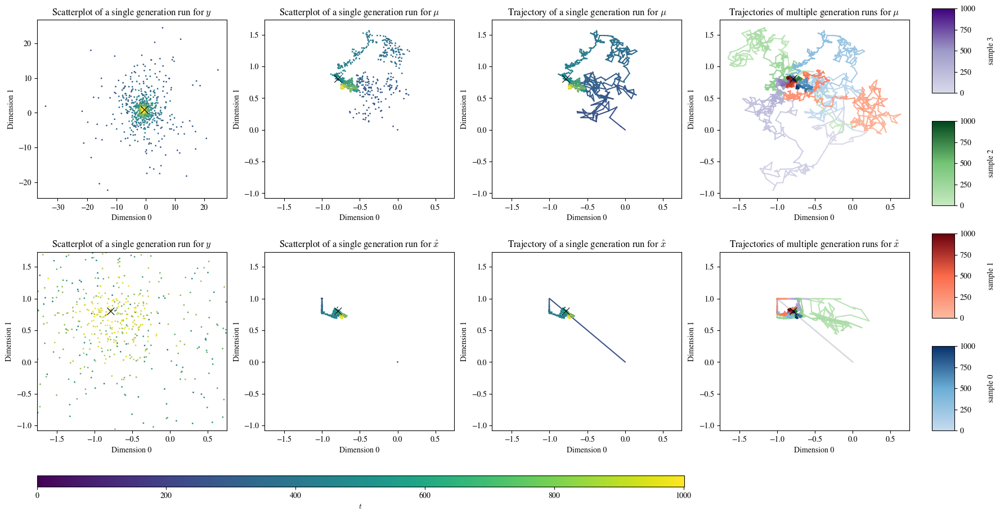

In [20]:
visualize_generation(samples, mus, ys)

Top row, from left to right:
- A scatter plot of samples $\mathbf{y}$ for a single run, whose color transitions from purple to yellow over the course of the generation process. This is the same plot as the bottom left plot but with zoomed-out axes.
- A scatter plot of $\bm{\mu}$ for a single run, whose color transitions from purple to yellow over the course of the generation process.
- The trajectory of $\bm{\mu}$ for a single run, whose color transitions from purple to yellow over the course of the generation process.
- The trajectores of $\bm{\mu}$ for a multiple runs. Each color indicates a different run and the saturation transitions from light to dark over the course of the generation process.

Bottom row, from left to right:
- A scatter plot of samples $\mathbf{y}$ for a single run, whose color transitions from purple to yellow over the course of the generation process. This is the same plot as the top left plot but with axes that are the same as the other plots.
- A scatter plot of $\mathbf{\hat{x}}$ for a single run, whose color transitions from purple to yellow over the course of the generation process.
- The trajectory of $\mathbf{\hat{x}}$ for a single run, whose color transitions from purple to yellow over the course of the generation process.
- The trajectores of $\mathbf{}$ for a multiple runs. Each color indicates a different run and the saturation transitions from light to dark over the course of the generation process.

Note:
- The spread of samples $\mathbf{y}$ is much larger than the spread of the parameter updates for $\bm{\mu}$.
- The spread of the parameter updates for $\bm{\mu}$ is larger than the spread of the data estimates $\hat{\mathbf{x}}$.
- The $\hat{\mathbf{x}}$ is clipped to be in [-1, 1].
- The parameter trajectories $\bm{\mu}$ and data predictions $\hat{\mathbf{x}}$ begin at $[0, 0]$.
- The data predictions $\hat{\mathbf{x}}$ shoot directly towards the ground truth data $[-0.8, 0.8]$, overshoots it, and then gradually hones in on it.

## Visualize trajectories and the Bayesian flow distribution
We now create an animation that overlays the trajectories of $\hat{\mathbf{x}}$ (green) and $\bm{\mu}$ (white), along with the samples $\mathbf{y}$ (pink),  on top of a log-scale heatmap of the Bayesian flow distribution. The red dashed lines mark the boundaries that we clip the $\hat{\mathbf{x}}$ to.

In [17]:
mu, var = bayesian_flow_distribution(x, ts[0], sampling_cfg.sigma_1)

In [18]:
def exponential_decay(t, lambda_val=0.05):
    """Preferred when a rapid fade-out is desired. 

    Provides a clear emphasis on the most recent data points, with older points 
    quickly fading into the background.
    """
    return np.exp(-lambda_val * t)

def power_law_decay(t, lambda_val=0.05, k=2):
    """Used when a more extended emphasis on historical data is desired.
    
    Starts slow, emphasizing older data points more than an exponential decay 
    would, but eventually decays faster for very old data points.
    """
    return 1 / (1 + lambda_val * t)**k

def constant(t):
    return 1

def gaussian_2d(x, y, mu, var):
    Z = norm.pdf(x[:, np.newaxis], mu[1], np.sqrt(var)) * norm.pdf(y, mu[0], np.sqrt(var))
    Z = np.clip(Z, 1e-10, None)
    return Z

def visualize_animation(
        data, flow_mu, flow_var, mu_trajectory, x_hat_trajectory, y_samples, 
        subsample_every=10, decay_type="exponential", x_lim=(-1.5, 1.5), y_lim=(-1.5, 1.5), res=500):
    flow_mu = flow_mu[::subsample_every]
    flow_var = flow_var[::subsample_every]
    mu_trajectory = mu_trajectory[::subsample_every]
    x_hat_trajectory = x_hat_trajectory[::subsample_every]
    y_samples = y_samples[::subsample_every]
    flow_var = np.clip(flow_var, 1e-5, None)

    T = len(flow_mu)

    decay_functions = {
        "exponential": exponential_decay,
        "power_law": power_law_decay,
        "constant": constant
    }

    if decay_type not in decay_functions:
        raise ValueError(f"Invalid decay_type. Allowed values are: {list(decay_functions.keys())}")

    x = np.linspace(x_lim[0], x_lim[1], res)
    y = np.linspace(y_lim[0], y_lim[1], res)

    # Compute global maximum for color normalization
    global_max = max([gaussian_2d(x, y, flow_mu[i], flow_var[i]).max() for i in range(T)])

    # Plot Bayesian flow distribution
    fig, ax = plt.subplots(figsize=(6, 5))
    cax = ax.imshow(
        np.zeros((res, res)), 
        extent=[x_lim[0], x_lim[1], y_lim[0], y_lim[1]], 
        origin='lower', 
        cmap='plasma', 
        aspect='auto', 
        norm=LogNorm(vmin=1e-10, vmax=global_max))
    cbar = fig.colorbar(cax, ax=ax, label='$p_F(\\theta | x; t)$')
    ax.set_title('Bayesian Flow Networks: Generation at $t=1$')
    ax.set_xlabel('Dimension 0')
    ax.set_ylabel('Dimension 1')

    # Draw x limits for predicted x_hats
    square = plt.Rectangle((-1,-1),2,2,fill=False,color='red',linestyle='--',linewidth=1)
    ax.add_patch(square)

    ax.set_xlim(x_lim)
    ax.set_ylim(y_lim)

    ax.legend(handles=[
            # data x
            plt.Line2D([0], [0], linestyle='None', color='cyan', marker='*', markersize=10, markeredgewidth=1.5, label='$x$'),
            # samples y
            plt.Line2D([0], [0], linestyle='None', marker='o', color='magenta', markerfacecolor='magenta', markersize=5, label='$y_t$'),
            # predictions x_hat
            plt.Line2D([0], [0], color='lime', linewidth=2, label='$\hat{x}_t$'),
            # parameters mu
            plt.Line2D([0], [0], color='white', linewidth=2, label='$\mu_t$'),
            # x limits
            plt.Line2D([0], [0], color='red', linestyle='--', linewidth=2, label='$[x_{min}, x_{max}]$')  
            ],
        loc='lower right',
        )
    
    fig.tight_layout()

    def update(t):
        Z = gaussian_2d(x, y, flow_mu[t], flow_var[t])
        cax.set_array(Z)

        # Clear previous trajectory segments and scatter points
        for line in ax.lines[::-1]:
            line.remove()
        for collection in ax.collections[::-1]:
            collection.remove()

        decay_func = decay_functions[decay_type]
        for i in range(1, t+1):
            alpha = decay_func(t-i)
            alpha = np.clip(alpha, 0.2, 1)

            # Plot x_hat trajectory
            ax.plot(
                x_hat_trajectory[i-1:i+1, 0], 
                x_hat_trajectory[i-1:i+1, 1], 
                color='lime', alpha=alpha, linewidth=2)

            # Plot mu trajectory
            ax.plot(
                mu_trajectory[i-1:i+1, 0], 
                mu_trajectory[i-1:i+1, 1], 
                color='white', alpha=alpha, linewidth=2)
            
            # Scatter plot ys
            ax.scatter(
                y_samples[i-1:i+1, 0], 
                y_samples[i-1:i+1, 1], 
                color='magenta', alpha=alpha, s=5)

            # Mark data x
            ax.plot(*data, 
                marker='*', 
                color='cyan',
                markersize=10, 
                markeredgewidth=1.5, 
                linestyle='None', 
                label='$x$')
            
        ax.set_title(f'Bayesian Flow Networks: Generation at $t={t+1}$')
        return cax,

    ani = FuncAnimation(fig, update, frames=T, blit=True)

    return ani

### Zoomed in

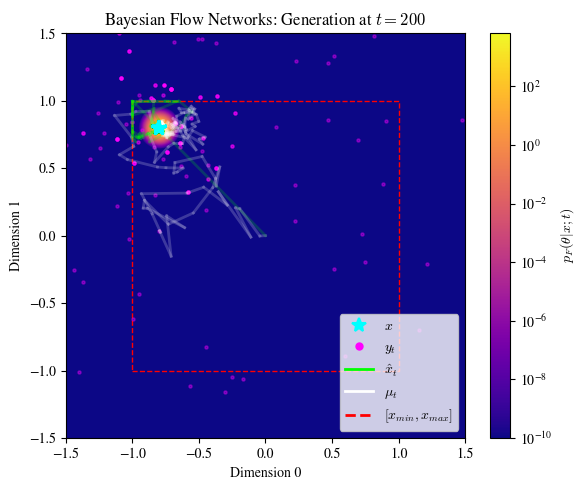

In [19]:
# This takes about 5 minutes to generate
ani = visualize_animation(
    x, mu, var, mus[0], samples[0], ys[0], subsample_every=5)

# Displaying the animation within the notebook
HTML(ani.to_jshtml())    

In [20]:
ani.save('bayesian_flow_with_trajectories.gif', writer='pillow', dpi=300, fps=30)

In [21]:
ani.save('bayesian_flow_with_trajectories.mp4', writer='ffmpeg', dpi=300, fps=30)

### Zoomed out

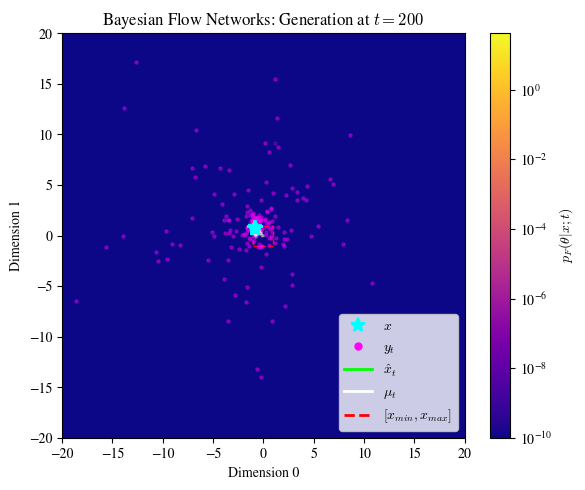

In [22]:
# This takes about 5 minutes to generate
ani = visualize_animation(
    x, mu, var, mus[0], samples[0], ys[0], subsample_every=5, x_lim=(-20,20), y_lim=(-20,20))

# Displaying the animation within the notebook
HTML(ani.to_jshtml())  

In [23]:
ani.save('bayesian_flow_with_trajectories_zoomed_out.gif', writer='pillow', dpi=300, fps=30)

In [ ]:
ani.save('bayesian_flow_with_trajectories_zoomed_out.mp4', writer='ffmpeg', dpi=300, fps=30)